# Install libraries

In [57]:
import os
import matplotlib.pyplot as plt
from netCDF4 import Dataset as netcdf_dataset
import numpy as np

import cartopy
from cartopy import config
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# Load & examine dataset

In [58]:
fname = 'gdas.t00z.sfluxgrbf000..nc'

In [59]:
dataset = netcdf_dataset(fname)

# Different variables in nc file
- 'time': This variable represents the initial time of forecast in seconds since 1970-01-01.
- 'step': This variable represents the time since forecast_reference_time in hours.
- 'hybrid': This variable represents the hybrid level.
- 'latitude': This variable represents the latitude in degrees north.
- longitude: This variable represents the longitude in degrees east.
- 'valid_time': This variable represents the time in seconds since 1970-01-01.
- 'gh': This variable represents the geopotential height in gpm.
- 't': This variable represents the temperature in K.
- 'q': This variable represents the specific humidity in kg kg**-1.
- 'u': This variable represents the U component of wind in m s**-1.
- 'v': This variable represents the V component of wind in m s**-1.

# Prep & examine variables

In [62]:
u_wind = dataset.variables['u'][:]
v_wind = dataset.variables['v'][:]

In [63]:
lats = dataset.variables['latitude'][:]
lons = dataset.variables['longitude'][:]

# Calculate variables from other vars

In [66]:
wind_speed = np.sqrt(u_wind**2 + v_wind**2)
ws_direction = np.arctan2(v_wind,u_wind)
ws_daily_avg = np.nanmean(wind_speed, axis=0)
u_daily_avg = np.nanmean(u_wind, axis=0)
v_daily_avg = np.nanmean(v_wind, axis=0)
ws_daily_avg_direction = np.arctan2(v_daily_avg, u_daily_avg)

In [69]:
lats = dataset.variables['latitude'][:]
lons = dataset.variables['longitude'][:]

# Create color maps

In [82]:
my_cmap = plt.colormaps['twilight']
my_cmap2 = plt.colormaps['twilight_shifted']
my_cmap3 = plt.colormaps['PuBuGn']
my_cmap4 = plt.colormaps['BuPu']
my_cmap5 = plt.colormaps['Spectral']
my_cmap6 = plt.colormaps['plasma']

# Plot maps

## Map V1

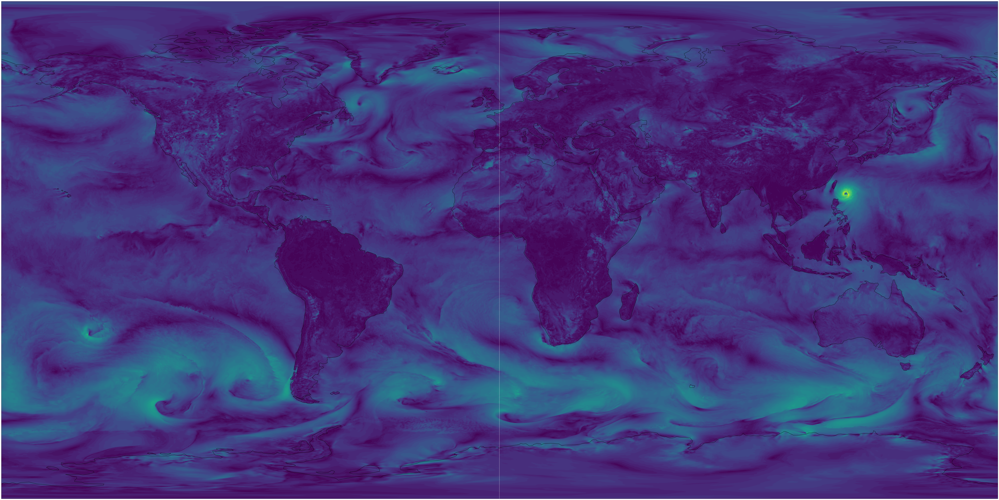

In [71]:
plt.figure(figsize=(100,50))
ax = plt.axes(projection=ccrs.PlateCarree())
plt.contourf(lons, lats, wind_speed, 60,
             transform=ccrs.PlateCarree())
ax.coastlines()
plt.show()

## Map V2

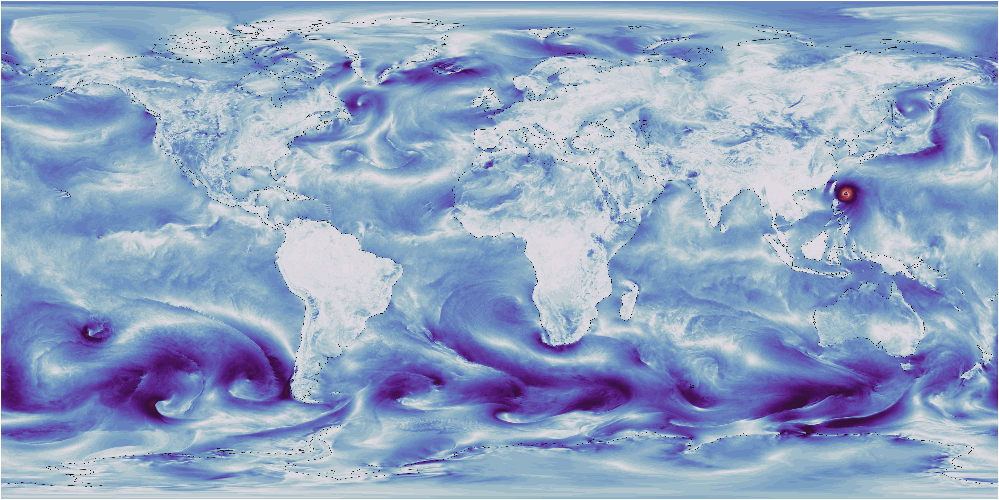

In [72]:
plt.figure(figsize=(100,50))
ax = plt.axes(projection=ccrs.PlateCarree())
plt.contourf(lons, lats, wind_speed, 60,
             transform=ccrs.PlateCarree(),cmap=my_cmap)
ax.coastlines()
plt.show()

## Map V3

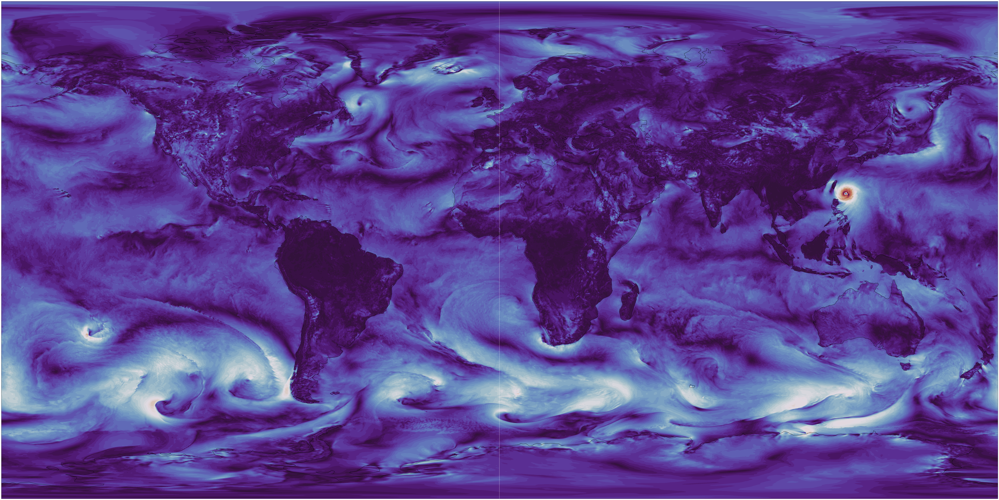

In [17]:
plt.figure(figsize=(100,50))
ax = plt.axes(projection=ccrs.PlateCarree())
plt.contourf(lons, lats, wind_speed, 60,
             transform=ccrs.PlateCarree(),cmap=my_cmap2)
ax.coastlines()
plt.show()

## Map V4

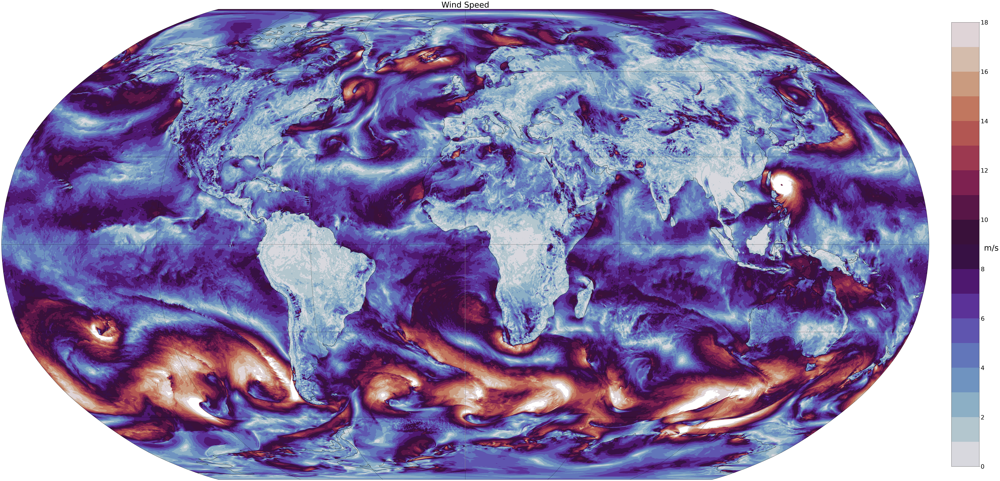

In [112]:
# Set the figure size, projection, and extent
fig = plt.figure(figsize=(100,50))
ax = plt.axes(projection=ccrs.Robinson())
ax.set_global()
ax.coastlines(resolution="110m",linewidth=1)
ax.gridlines(linestyle='--',color='black')

# Plot windspeed:
# Set contour levels, then draw the plot and a colorbar
clevs = np.arange(0,19,1)
plt.contourf(lons, lats, wind_speed, clevs, transform=ccrs.PlateCarree(),cmap=my_cmap)
plt.title('Wind Speed', size=40)
cb = plt.colorbar(ax=ax, orientation="vertical", pad=0.02, aspect=16, shrink=0.8)
cb.set_label('m/s',size=40,rotation=0,labelpad=15)
cb.ax.tick_params(labelsize=30)
     

# Plot maps with arrows

## Map arrows V1

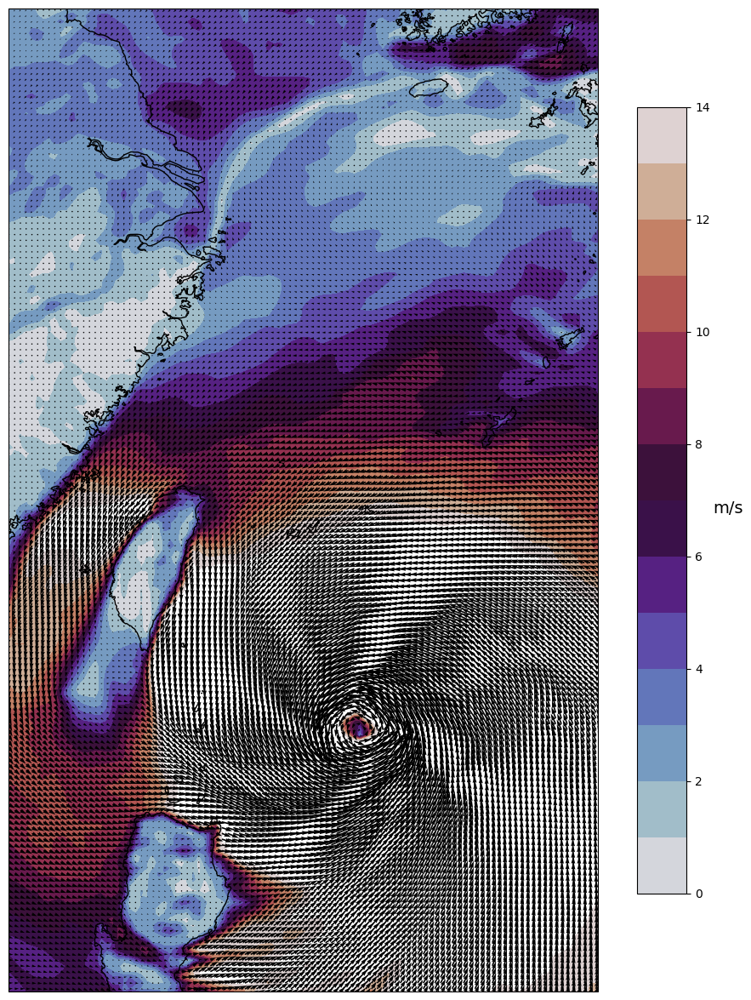

In [110]:
# Set the figure size, projection, and extent
fig = plt.figure(figsize=(30,15))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.set_extent([118, 130, 15, 35], crs=ccrs.PlateCarree())
ax.coastlines(resolution="10m",linewidth=1)

# Plot windspeed
clevs = np.arange(0,14.5,1) #specifies the contour levels for the wind speed (in meters per second).
plt.contourf(lons, lats, wind_speed, clevs, transform=ccrs.PlateCarree(),cmap=my_cmap)
cb = plt.colorbar(ax=ax, orientation="vertical", pad=0.02, aspect=16, shrink=0.8)
cb.set_label('m/s',size=14,rotation=0,labelpad=15)
cb.ax.tick_params(labelsize=10)
# Overlay wind vectors
qv = plt.quiver(lons, lats, u_wind, v_wind, scale=800, color='k')
plt.show()